In [ ]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
%matplotlib inline



In [ ]:
def undistort(image, gray):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objectpoints, imagepoints, gray.shape[::-1], None, None)
    return cv2.undistort(image, mtx, dist, None, mtx)


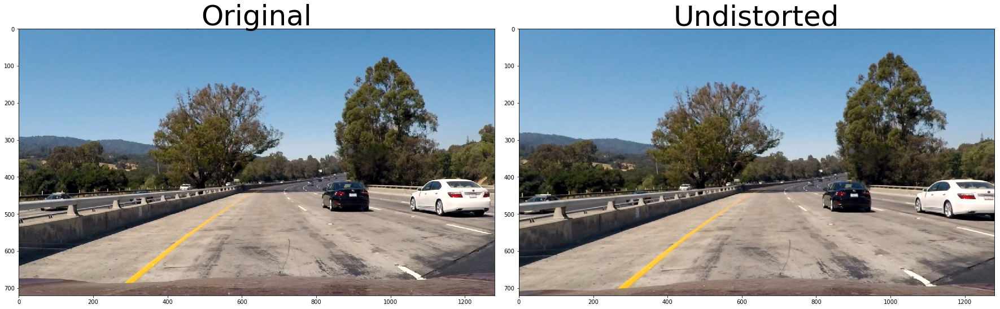

In [94]:
    for i in range(1, 2):
        fname = test_images_dir + "/test" + str(i) + ".jpg"
        image = mpimg.imread(fname)
        gray = grayscale(image)
        undist = undistort(image, gray)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original', fontsize=50)
        ax2.imshow(undist)
        ax2.set_title('Undistorted', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


In [ ]:
def calibrate_chessboard(x_dim=9, y_dim=6, drawCorners=0, writeToFile=0):
    out = []  # Output images

    objp = np.zeros((y_dim * x_dim, 3), np.float32)
    objp[:, :2] = np.mgrid[0:x_dim, 0:y_dim].T.reshape(-1, 2)  # x, y coordinates

    images = glob.glob(calibration_dir + '/calibration*.jpg')

    for fname in images:
        img = mpimg.imread(fname)

        gray = grayscale(img)

        ret, corners = cv2.findChessboardCorners(gray, (x_dim, y_dim), None)

        if ret:
            imagepoints.append(corners)
            objectpoints.append(objp)

            if drawCorners:
                img = cv2.drawChessboardCorners(img, (x_dim, y_dim), corners, ret)

            undist = undistort(img, gray)

            out.append(undist)

            if writeToFile:
                f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
                f.tight_layout()
                ax1.imshow(img)
                ax1.set_title('Original', fontsize=50)
                ax2.imshow(undist)
                ax2.set_title('Undistorted', fontsize=50)
                plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
                #plt.savefig(output_dir + '/out_' + fname.split('/')[-1])

    return out


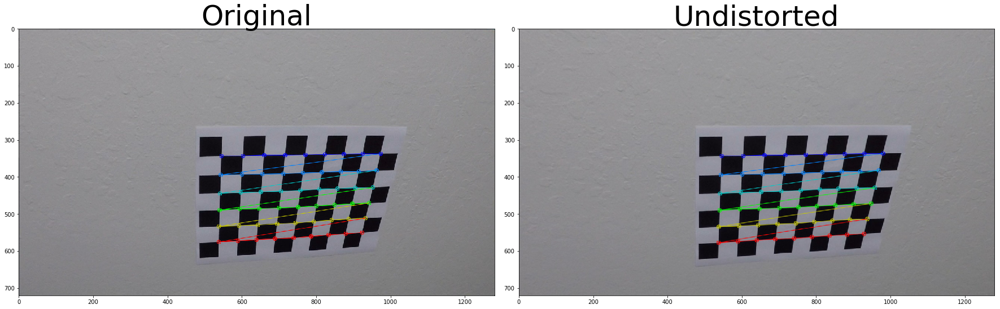

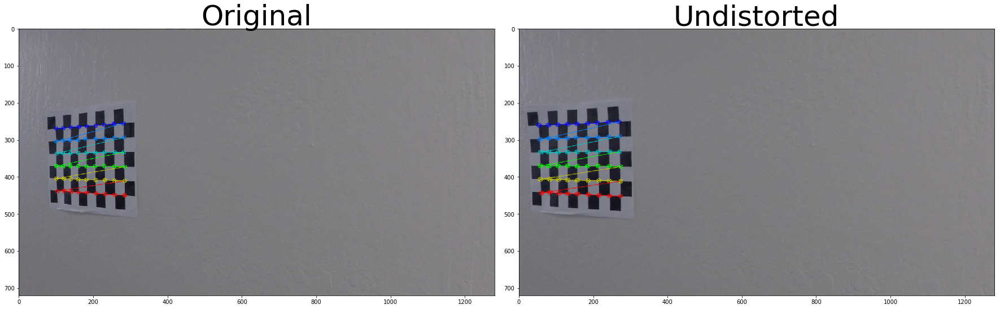

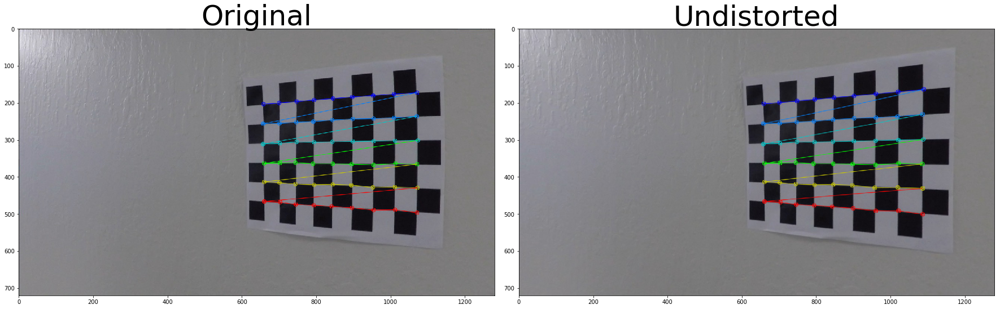

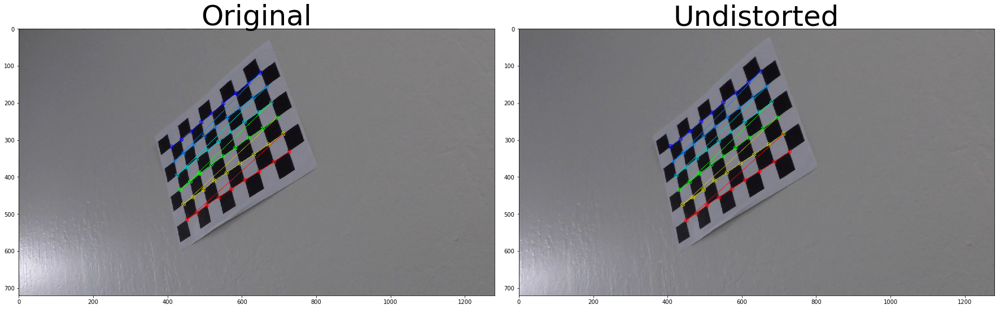

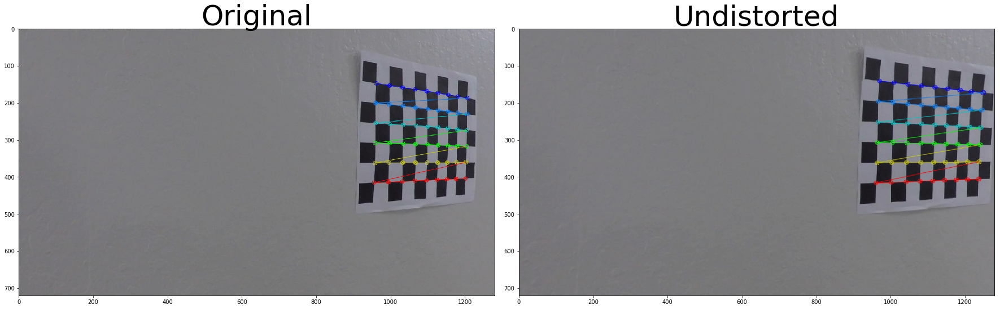

...

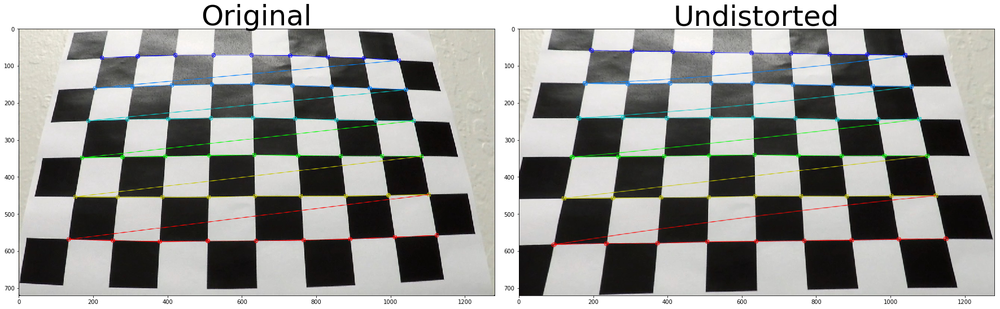

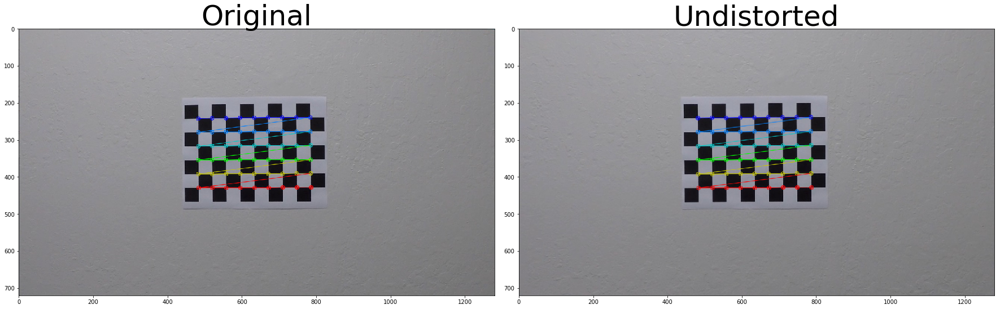

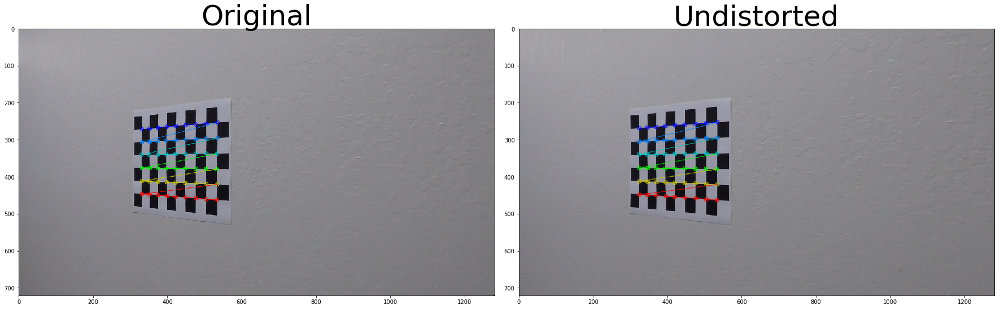

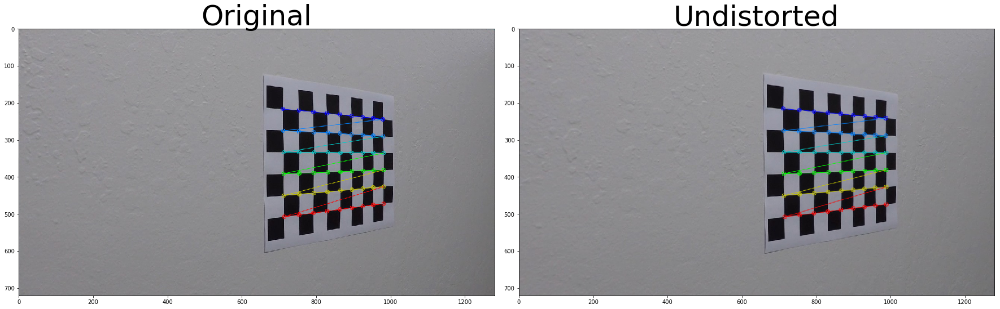

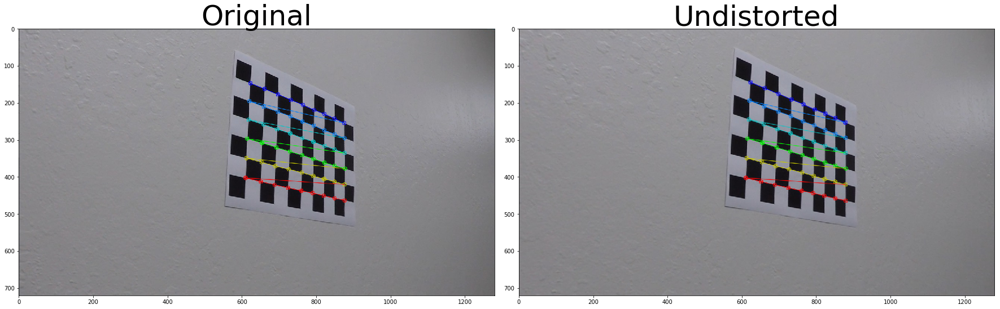

In [95]:
out = calibrate_chessboard(drawCorners=1, writeToFile=1)

In [97]:
def direction_threshold(gray, sobel_kernel=3, threshold=(0, np.pi / 2)):
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    abs_sobelx = np.absolute(sobel_x)
    abs_sobely = np.absolute(sobel_y)

    dir_grad = np.arctan2(abs_sobely, abs_sobelx)

    binary_output = np.zeros_like(dir_grad)
    binary_output[(dir_grad >= threshold[0]) & (dir_grad <= threshold[1])] = 1

    return binary_output


def magnitude_thresh(gray, sobel_kernel=3, threshold=(0, 255)):
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    mag_sobel = np.sqrt(sobel_x ** 2 + sobel_y ** 2)

    scale_factor = np.max(mag_sobel) / 255
    mag_scaled = (mag_sobel / scale_factor).astype(np.uint8)

    binary_output = np.zeros_like(mag_scaled)
    binary_output[(mag_scaled >= threshold[0]) & (mag_scaled <= threshold[1])] = 1

    return binary_output


def absolute_sobel_threshold(gray, orient='x', threshold=(0, 255), sobel_kernel=3):
    sobel = cv2.Sobel(gray, cv2.CV_64F, orient == 'x', orient == 'y')

    abs_sobel = np.absolute(sobel)

    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))

    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > threshold[0]) & (scaled_sobel < threshold[1])] = 1

    return binary_output


def saturation_threshold(image, threshold=(0, 255)):
    hlsimg = hls(image)

    S = hlsimg[:, :, 2]

    binary = np.zeros_like(S)
    binary[(S > threshold[0]) & (S <= threshold[1])] = 1

    return binary


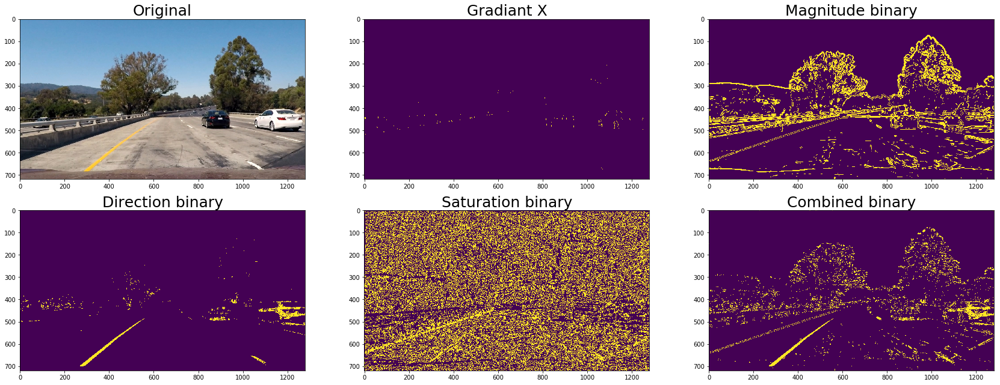

In [98]:
    for i in range(1, 2):
        fname = test_images_dir + "/test" + str(i) + ".jpg"
        image = mpimg.imread(fname)
        gray = grayscale(image)
        undist = undistort(image, gray)

        grad_x = absolute_sobel_threshold(gray, orient='x', sobel_kernel=kernel_size, threshold=(120, 255))
        grad_y = absolute_sobel_threshold(gray, orient='y', sobel_kernel=kernel_size, threshold=(20, 100))
        magnitude_binary = magnitude_thresh(gray, sobel_kernel=kernel_size, threshold=(30, 100))
        direction_binary = direction_threshold(gray, sobel_kernel=kernel_size, threshold=(0.7, 1.3))
        saturation_binary = saturation_threshold(undist, threshold=(200, 255))
        combined_binary = np.zeros_like(direction_binary)
        combined_binary[((grad_x == 1) & (grad_y == 1)) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1
        combined_binary[(grad_x == 1) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1

        fig = plt.figure(figsize=(24, 9))
        ax1 = fig.add_subplot(231)
        ax1.set_title('Original', fontsize=25)
        ax1.imshow(image)
        ax2 = fig.add_subplot(232)
        ax2.set_title('Gradiant X', fontsize=25)
        ax2.imshow(grad_x)
        ax3 = fig.add_subplot(233)
        ax3.set_title('Magnitude binary', fontsize=25)
        ax3.imshow(magnitude_binary)
        ax4 = fig.add_subplot(234)
        ax4.set_title('Direction binary', fontsize=25)
        ax4.imshow(saturation_binary)
        ax5 = fig.add_subplot(235)
        ax5.set_title('Saturation binary', fontsize=25)
        ax5.imshow(direction_binary)
        ax5 = fig.add_subplot(236)
        ax5.set_title('Combined binary', fontsize=25)
        ax5.imshow(combined_binary)
        plt.tight_layout()

        """
        f, (ax1, ax2) = plt.subplots(2, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original', fontsize=50)
        ax2.imshow(combined_binary)
        ax2.set_title('Saturation Binary', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        """


In [99]:
def birds_eye(image):

    src = np.float32([[200, 720], [1100, 720], [595, 450], [685, 450]])
    dst = np.float32([[300, 720], [980, 720], [300, 0], [980, 0]])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    img_size = (image.shape[1], image.shape[0])
    warped_image = cv2.warpPerspective(image, M, img_size)
    return warped_image, M, Minv


def histogram(image):
    return np.sum(image[image.shape[0] // 2:, :], axis=0)


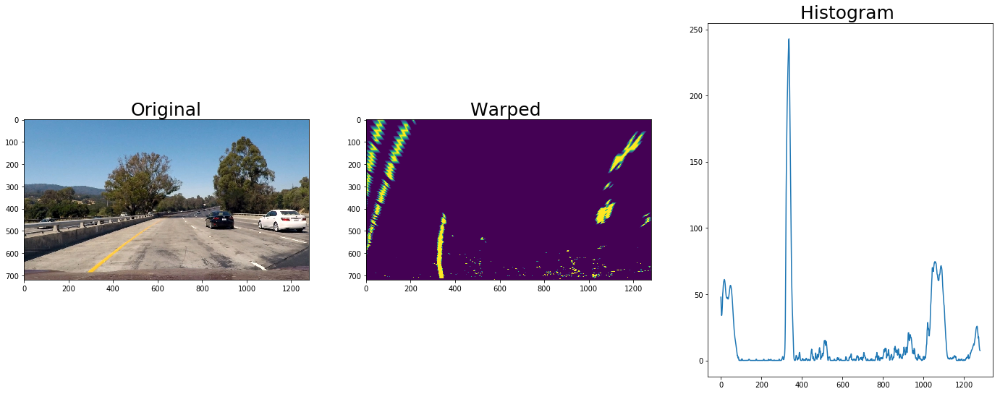

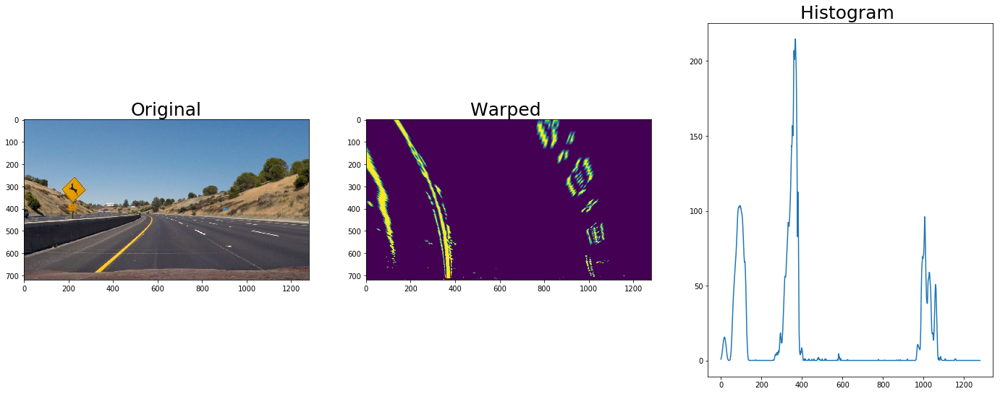

In [100]:
    for i in range(1, 3):
        fname = test_images_dir + "/test" + str(i) + ".jpg"
        image = mpimg.imread(fname)
        gray = grayscale(image)
        undist = undistort(image, gray)

        grad_x = absolute_sobel_threshold(gray, orient='x', sobel_kernel=kernel_size, threshold=(120, 255))
        grad_y = absolute_sobel_threshold(gray, orient='y', sobel_kernel=kernel_size, threshold=(20, 100))
        magnitude_binary = magnitude_thresh(gray, sobel_kernel=kernel_size, threshold=(30, 100))
        direction_binary = direction_threshold(gray, sobel_kernel=kernel_size, threshold=(0.7, 1.3))
        saturation_binary = saturation_threshold(undist, threshold=(200, 255))
        combined_binary = np.zeros_like(direction_binary)
        combined_binary[((grad_x == 1) & (grad_y == 1)) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1
        combined_binary[(grad_x == 1) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1
        warped_image, M, Minv = birds_eye(combined_binary)
        hist = histogram(warped_image)
        
        
        fig = plt.figure(figsize=(24, 9))
        ax1 = fig.add_subplot(131)
        ax1.set_title('Original', fontsize=25)
        ax1.imshow(image)
        ax2 = fig.add_subplot(132)
        ax2.set_title('Warped ', fontsize=25)
        ax2.imshow(warped_image)
        ax3 = fig.add_subplot(133)
        ax3.set_title('Histogram ', fontsize=25)
        plt.plot(hist)        
        


In [101]:
def sliding_window(image, histogram_img, num_windows=9, margin=100, minpix=50, writeToFile=0, filename=''):
    out_image = np.dstack((image, image, image)) * 255

    midpoint = np.int(histogram_img.shape[0] / 2)
    leftx_pt = np.argmax(histogram_img[:midpoint])
    rightx_pt = np.argmax(histogram_img[midpoint:]) + midpoint

    window_height = np.int(image.shape[0] / num_windows)

    nonzero_arr = image.nonzero()
    nonzero_y_arr = np.array(nonzero_arr[0])
    nonzero_x_arr = np.array(nonzero_arr[1])

    leftx_current = leftx_pt
    rightx_current = rightx_pt

    left_lane_indices = []
    right_lane_indices = []

    for window in range(num_windows):
        window_y_low = image.shape[0] - (window + 1) * window_height
        window_y_high = image.shape[0] - window * window_height
        window_xleft_low = leftx_current - margin
        window_xleft_high = leftx_current + margin
        window_xright_low = rightx_current - margin
        window_xright_high = rightx_current + margin

        cv2.rectangle(out_image, (window_xleft_low, window_y_low), (window_xleft_high, window_y_high), (0, 255, 0), 2)
        cv2.rectangle(out_image, (window_xright_low, window_y_low), (window_xright_high, window_y_high), (0, 255, 0), 2)

        good_left_inds = ((nonzero_y_arr >= window_y_low) & (nonzero_y_arr < window_y_high) & (nonzero_x_arr >= window_xleft_low) & (
        nonzero_x_arr < window_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzero_y_arr >= window_y_low) & (nonzero_y_arr < window_y_high) & (nonzero_x_arr >= window_xright_low) & (
        nonzero_x_arr < window_xright_high)).nonzero()[0]

        left_lane_indices.append(good_left_inds)
        right_lane_indices.append(good_right_inds)

        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzero_x_arr[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzero_x_arr[good_right_inds]))

    left_lane_indices = np.concatenate(left_lane_indices)
    right_lane_indices = np.concatenate(right_lane_indices)

    left_pos_x = nonzero_x_arr[left_lane_indices]
    left_pos_y = nonzero_y_arr[left_lane_indices]
    right_pos_x = nonzero_x_arr[right_lane_indices]
    right_pos_y = nonzero_y_arr[right_lane_indices]

    left_poly_fit = np.polyfit(left_pos_y, left_pos_x, 2)
    right_poly_fit = np.polyfit(right_pos_y, right_pos_x, 2)

    if writeToFile:
        ploty = np.linspace(0, image.shape[0] - 1, image.shape[0])
        left_poly_fitx = left_poly_fit[0] * ploty ** 2 + left_poly_fit[1] * ploty + left_poly_fit[2]
        right_fitx = right_poly_fit[0] * ploty ** 2 + right_poly_fit[1] * ploty + right_poly_fit[2]

        out_image[nonzero_y_arr[left_lane_indices], nonzero_x_arr[left_lane_indices]] = [255, 0, 0]
        out_image[nonzero_y_arr[right_lane_indices], nonzero_x_arr[right_lane_indices]] = [0, 0, 255]

        plt.figure()
        plt.imshow(out_image)
        plt.plot(left_poly_fitx, ploty, color='red')
        plt.plot(right_fitx, ploty, color='blue')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        #plt.savefig(filename)

    return left_poly_fit, right_poly_fit



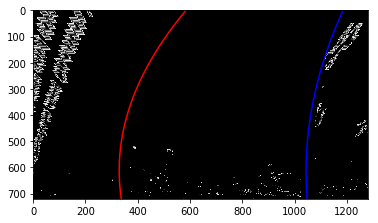

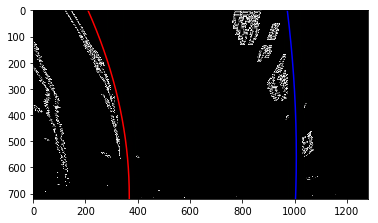

In [102]:
    #left_fit_previous = []

    for i in range(1, 3):
        fname = test_images_dir + "/test" + str(i) + ".jpg"
        image = mpimg.imread(fname)
        gray = grayscale(image)
        undist = undistort(image, gray)

        grad_x = absolute_sobel_threshold(gray, orient='x', sobel_kernel=kernel_size, threshold=(120, 255))
        grad_y = absolute_sobel_threshold(gray, orient='y', sobel_kernel=kernel_size, threshold=(20, 100))
        magnitude_binary = magnitude_thresh(gray, sobel_kernel=kernel_size, threshold=(30, 100))
        direction_binary = direction_threshold(gray, sobel_kernel=kernel_size, threshold=(0.7, 1.3))
        saturation_binary = saturation_threshold(undist, threshold=(200, 255))
        combined_binary = np.zeros_like(direction_binary)
        combined_binary[((grad_x == 1) & (grad_y == 1)) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1
        combined_binary[(grad_x == 1) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1
        warped_image, M, Minv = birds_eye(combined_binary)
        hist = histogram(warped_image)

        left_poly_fit = []
        right_poly_fit = []

        if len(left_fit_previous) == 0:
            left_poly_fit, right_poly_fit = sliding_window(warped_image, hist, writeToFile=1,
                                                filename=output_dir + '/slide_' +                                                       fname.split('/')[-1], margin=30)
        else: 
            left_poly_fit, right_poly_fit = margin_search(warped_image, left_fit_previous, right_fit_previous, margin=30)

        
        


In [103]:
def margin_search(image, left_poly_fit, right_poly_fit, margin=100, writeToFile=0, filename=''):
    out_image = np.dstack((image, image, image)) * 255

    nonzero_arr = image.nonzero()
    nonzero_y_arr = np.array(nonzero_arr[0])
    nonzero_x_arr = np.array(nonzero_arr[1])

    left_lane_indices = ((nonzero_x_arr > (left_poly_fit[0] * (nonzero_y_arr ** 2) + left_poly_fit[1] * nonzero_y_arr + left_poly_fit[2] - margin)) & (
    nonzero_x_arr < (left_poly_fit[0] * (nonzero_y_arr ** 2) + left_poly_fit[1] * nonzero_y_arr + left_poly_fit[2] + margin)))
    right_lane_indices = (
    (nonzero_x_arr > (right_poly_fit[0] * (nonzero_y_arr ** 2) + right_poly_fit[1] * nonzero_y_arr + right_poly_fit[2] - margin)) & (
    nonzero_x_arr < (right_poly_fit[0] * (nonzero_y_arr ** 2) + right_poly_fit[1] * nonzero_y_arr + right_poly_fit[2] + margin)))

    left_pos_x = nonzero_x_arr[left_lane_indices]
    left_pos_y = nonzero_y_arr[left_lane_indices]
    right_pos_x = nonzero_x_arr[right_lane_indices]
    right_pos_y = nonzero_y_arr[right_lane_indices]

    left_poly_fit = np.polyfit(left_pos_y, left_pos_x, 2)
    right_poly_fit = np.polyfit(right_pos_y, right_pos_x, 2)

    if writeToFile:
        ploty = np.linspace(0, image.shape[0] - 1, image.shape[0])
        left_poly_fitx = left_poly_fit[0] * ploty ** 2 + left_poly_fit[1] * ploty + left_poly_fit[2]
        right_fitx = right_poly_fit[0] * ploty ** 2 + right_poly_fit[1] * ploty + right_poly_fit[2]

        out_image[nonzero_y_arr[left_lane_indices], nonzero_x_arr[left_lane_indices]] = [255, 0, 0]
        out_image[nonzero_y_arr[right_lane_indices], nonzero_x_arr[right_lane_indices]] = [0, 0, 255]

        plt.figure()
        plt.imshow(out_image)
        plt.plot(left_poly_fitx, ploty, color='red')
        plt.plot(right_fitx, ploty, color='blue')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        #plt.savefig(filename)

    return left_poly_fit, right_poly_fit


In [104]:
def calculate_radius_of_curvature(image, left_poly_fit, right_poly_fit):
    ploty = np.linspace(0, image.shape[0] - 1, image.shape[0])
    yeval = np.max(ploty)
    left_radius_curvature = ((1 + (2 * left_poly_fit[0] * yeval + left_poly_fit[1]) ** 2) ** 1.5) / np.absolute(2 * left_poly_fit[0])
    right_radius_curvature = ((1 + (2 * right_poly_fit[0] * yeval + right_poly_fit[1]) ** 2) ** 1.5) / np.absolute(2 * right_poly_fit[0])

    ym_per_pix = 30 / 720
    xm_per_pix = 3.7 / 700

    left_poly_fitx = left_poly_fit[0] * ploty ** 2 + left_poly_fit[1] * ploty + left_poly_fit[2]
    right_fitx = right_poly_fit[0] * ploty ** 2 + right_poly_fit[1] * ploty + right_poly_fit[2]

    left_fit_cr = np.polyfit(ploty * ym_per_pix, left_poly_fitx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty * ym_per_pix, right_fitx * xm_per_pix, 2)

    left_radius_curvature = ((1 + (2 * left_fit_cr[0] * yeval * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(
        2 * left_fit_cr[0])
    right_radius_curvature = ((1 + (2 * right_fit_cr[0] * yeval * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(
        2 * right_fit_cr[0])

    avg_radius_curvature = np.mean([left_radius_curvature, right_radius_curvature])

    return left_radius_curvature, right_radius_curvature, avg_radius_curvature


In [105]:
def distance_from_center(left_poly_fit, right_poly_fit):

    y = 700
    mid_x = 650
    xm_per_pix = 3.7 / 700

    x_left = left_poly_fit[0] * (y**2) + left_poly_fit[1] * y + left_poly_fit[2]
    x_right = right_poly_fit[0] * (y**2) + right_poly_fit[1] * y + right_poly_fit[2]
    num_meters = xm_per_pix * ((x_left + x_right) / 2 - mid_x)

    isleft = num_meters < 0
    num_meters = np.absolute(num_meters)

    str = "%.2fm %s" % (num_meters, 'left' if isleft else 'right')

    return str, isleft, num_meters


In [106]:
def draw_lines(undist, warped_image, left_poly_fit, right_poly_fit, Minv):
    warp_zero = np.zeros_like(warped_image).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    ploty = np.linspace(0, undist.shape[0] - 1, undist.shape[0])
    left_poly_fitx = left_poly_fit[0] * ploty ** 2 + left_poly_fit[1] * ploty + left_poly_fit[2]
    right_fitx = right_poly_fit[0] * ploty ** 2 + right_poly_fit[1] * ploty + right_poly_fit[2]

    pts_left = np.array([np.transpose(np.vstack([left_poly_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 192))

    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0]))

    return cv2.addWeighted(undist, 1, newwarp, 0.3, 0)


In [107]:
def fit_mvg_avg(left_poly_fit, right_poly_fit, num=5, diff=1e-3):

    global left_fit_previous, right_fit_previous

    left_fit_history.append(left_poly_fit)
    right_fit_history.append(right_poly_fit)

    leftHistLen = len(left_fit_history)
    if leftHistLen > 1:
        if leftHistLen > num:
            left_fit_history.pop(0)
        if len(right_fit_history) > num:
            right_fit_history.pop(0)

        left_fit_avg = np.average(left_fit_history, axis=0)
        right_fit_avg = np.average(right_fit_history, axis=0)

        if np.absolute(left_fit_avg[0] - left_fit_previous[0])  <= diff:
            left_fit_previous = left_fit_avg
        if np.absolute(right_fit_avg[0] - right_fit_previous[0])  <= diff:
            right_fit_previous = right_fit_avg
    else:
        left_fit_previous = left_poly_fit
        right_fit_previous = right_poly_fit

    return left_fit_previous, right_fit_previous   


In [108]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)


def hls(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2HLS).astype(np.float)


In [109]:
def project_pipeline(image, ksize=3, writeToFile=0, fname='', smoothing=1):
    new_img = np.copy(image)

    gray = grayscale(new_img)

    undist = undistort(new_img, gray)
    if writeToFile:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original', fontsize=50)
        ax2.imshow(undist)
        ax2.set_title('Undistorted', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        #plt.savefig(output_dir + '/undist_' + fname.split('/')[-1])

    grad_x = absolute_sobel_threshold(gray, orient='x', sobel_kernel=ksize, threshold=(120, 255))
    grad_y = absolute_sobel_threshold(gray, orient='y', sobel_kernel=ksize, threshold=(20, 100))
    magnitude_binary = magnitude_thresh(gray, sobel_kernel=ksize, threshold=(30, 100))
    direction_binary = direction_threshold(gray, sobel_kernel=ksize, threshold=(0.7, 1.3))
    saturation_binary = saturation_threshold(undist, threshold=(200, 255))

    combined_binary = np.zeros_like(direction_binary)
    combined_binary[((grad_x == 1) & (grad_y == 1)) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1
    combined_binary[(grad_x == 1) | ((magnitude_binary == 1) & (direction_binary == 1)) | (saturation_binary == 1)] = 1

    if writeToFile:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undist)
        ax1.set_title('Undistorted', fontsize=50)
        ax2.imshow(combined_binary, cmap='gray')
        ax2.set_title('Thresholded Gradiant Dir.', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        #plt.savefig(output_dir + '/combined_' + fname.split('/')[-1])

    warped_image, M, Minv = birds_eye(combined_binary)
    if writeToFile:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undist)
        ax1.set_title('Undistorted', fontsize=50)
        ax2.imshow(warped_image, cmap='gray')
        ax2.set_title('Undistorted - Warped', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        #plt.savefig(output_dir + '/persp_' + fname.split('/')[-1])

    hist = histogram(warped_image)
    if writeToFile:
        plt.figure()
        plt.plot(hist)
        #plt.savefig(output_dir + '/hist_' + fname.split('/')[-1])

    left_poly_fit = []
    right_poly_fit = []

    if len(left_fit_previous) == 0:
        if writeToFile:
            left_poly_fit, right_poly_fit = sliding_window(warped_image, hist, writeToFile=1,
                                                filename=output_dir + '/slide_' +                                                       fname.split('/')[-1], margin=30)
        else:
            left_poly_fit, right_poly_fit = sliding_window(warped_image, hist, margin=30)
    else: 
        left_poly_fit, right_poly_fit = margin_search(warped_image, left_fit_previous, right_fit_previous, margin=30)

    if smoothing:
        left_poly_fit, right_poly_fit = fit_mvg_avg(left_poly_fit, right_poly_fit, num=5, diff=2e-4)

    left_radius_curvature, right_radius_curvature, avg_radius_curvature = calculate_radius_of_curvature(warped_image, left_poly_fit, right_poly_fit)

    if writeToFile:
        print('left:', left_radius_curvature, 'meters, right:', right_radius_curvature, 'meters, avg:', avg_radius_curvature, 'meters')

    cv2.putText(undist, 'Radius of curvature: %.2fm' % avg_radius_curvature, (700, 40), cv2.FONT_HERSHEY_SIMPLEX, 1,
                (255, 255, 255), 2)

    str, left, meters = distance_from_center(left_poly_fit, right_poly_fit)

    cv2.putText(undist, "Distance from center: " + str, (700, 80), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

    new_img = draw_lines(undist, warped_image, left_poly_fit, right_poly_fit, Minv)
    if writeToFile:
        plt.figure()
        plt.imshow(new_img)
        #plt.savefig(output_dir + '/replot_' + fname.split('/')[-1])

    return new_img


left: 240.760486473 meters, right: 443.351188132 meters, avg: 342.055837302 meters


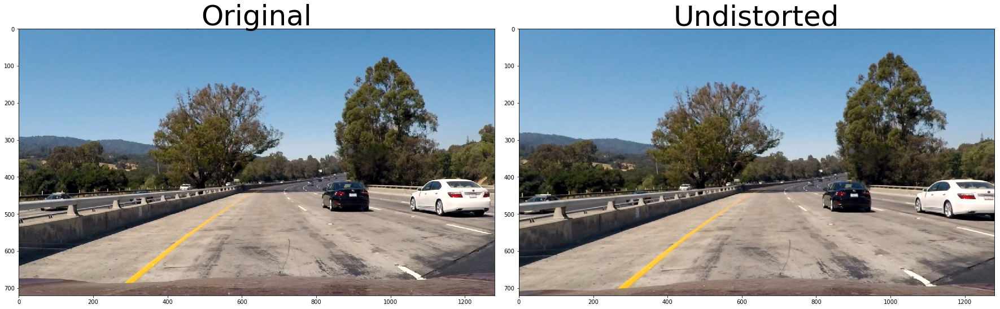

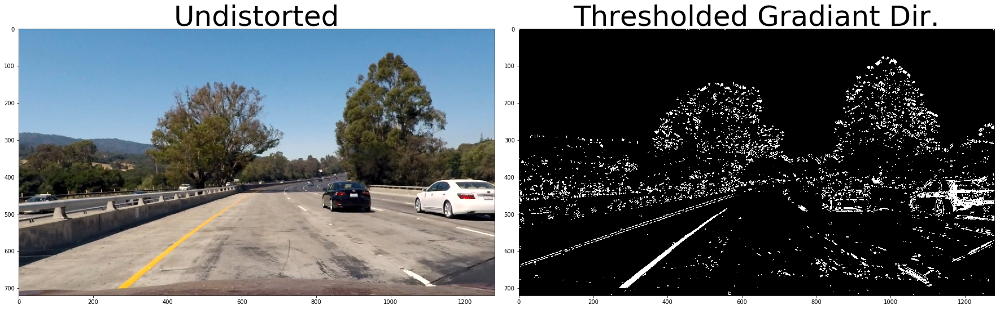

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


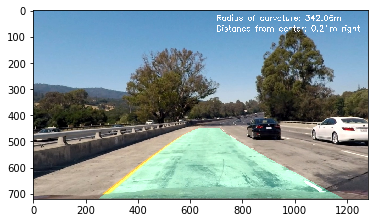

In [110]:
kernel_size = 15  # Kernel size

calibration_dir = './camera_cal'
test_images_dir = './test_images'
output_dir = './output_images'

# Calibration
objectpoints = []  # 3D points in real world space
imagepoints = []  # 2D points in image space

# Store fit values
left_fit_history = []
right_fit_history = []
left_fit_previous = []
right_fit_previous = []


def process_video(inFileName, outFileName):
    movie = VideoFileClip(inFileName).subclip(0,1)
    movie_processed = movie.fl_image(project_pipeline)
    movie_processed.write_videofile(outFileName, audio=False)

def test():
    calibrate_chessboard()

    for i in range(1, 2):
        fname = test_images_dir + "/test" + str(i) + ".jpg"
        image = mpimg.imread(fname)
        project_pipeline(image, ksize=kernel_size, writeToFile=1, fname=fname, smoothing=0)


def project(fileName):
    # Calibrate the camera lens using chessboard images
    calibrate_chessboard()

    # Process the video
    process_video(fileName, output_dir + '/out_' + fileName.split('/')[-1])


test()
#project('./project_video.mp4')
# project('./challenge_video.mp4')

